In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('https://www.kaggle.com/code/nourabentaher/brats2019-2dunet/input'):
    for filename in filenames:
        pass

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
import os
import cv2
import glob
import PIL
import shutil
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from skimage import data
from skimage.util import montage 
import skimage.transform as skTrans
from skimage.transform import rotate
from skimage.transform import resize
from PIL import Image, ImageOps  

!pip install nilearn
!pip install nibabel
# neural imaging
import nilearn as nl
import nibabel as nib
import nilearn.plotting as nlplt

!pip install git+https://github.com/miykael/gif_your_nifti # nifti to gif 
import gif_your_nifti.core as gif2nif


# ml libs
import keras
import keras.backend as K
from keras.callbacks import CSVLogger
import tensorflow as tf
from tensorflow.keras.utils import plot_model
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, TensorBoard
from tensorflow.keras.layers.experimental import preprocessing


# Make numpy printouts easier to read.
np.set_printoptions(precision=3, suppress=True)

  Cloning https://github.com/miykael/gif_your_nifti to /tmp/pip-req-build-3tgu4iud
  Running command git clone --filter=blob:none --quiet https://github.com/miykael/gif_your_nifti /tmp/pip-req-build-3tgu4iud
  Resolved https://github.com/miykael/gif_your_nifti to commit bff01fef8a63b3c5ec314dfbb5f10c954fc7c6bc
  Preparing metadata (setup.py) ... done
  Created wheel for gif-your-nifti: filename=gif_your_nifti-0.2.0-py3-none-any.whl size=6281 sha256=e6780361b140af354bd4d41cad5b612f825a3fae7b88944cfcaf435374a3657e
  Stored in directory: /tmp/pip-ephem-wheel-cache-n5fbpuka/wheels/4a/8c/d1/b228c3b67231f7459e8f70d73f4dadaf65cd90692d41f43e88
Successfully built gif-your-nifti


In [3]:
# DEFINE seg-areas  
SEGMENT_CLASSES = {
    0 : 'NOT tumor',   
    1 : 'NECROTIC/CORE', # or NON-ENHANCING tumor CORE - RED
    2 : 'EDEMA',  # Green
    3 : 'ENHANCING' # original 4 -> converted into 3 later, Yellow
}

# there are 155 slices per volume
# to start at 5 and use 145 slices means we will skip the first 5 and last 5 
VOLUME_SLICES = 100 
VOLUME_START_AT = 22 # first slice of volume that we will include

IMG_SIZE=128

In [7]:
flair = glob.glob(TRAIN_DATASET_PATH + '**/*_flair.nii')

In [9]:
for f in flair:
    test_image_flair=nib.load(f).get_fdata()
    test_image_flair[:,:,test_image_flair.shape[0]//2-slice_w], cmap = 'gray'

ValueError: too many values to unpack (expected 2)

Text(0.5, 1.0, 'Mask')

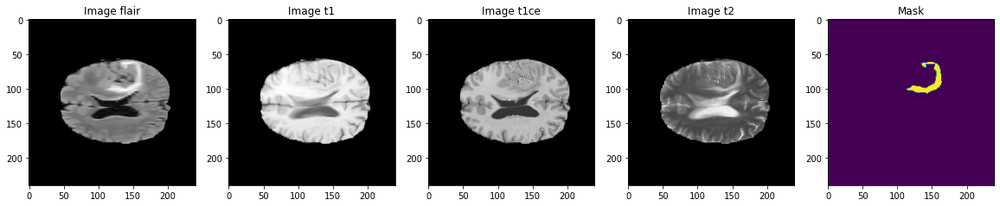

In [6]:
TRAIN_DATASET_PATH = '../input/brain-tumor-segmentation-brats-2019/MICCAI_BraTS_2019_Data_Training/HGG/'
#VALIDATION_DATASET_PATH = '../input/d/debobratachakraborty/brats2019-dataset/MICCAI_BraTS_2019_Data_Training/'

test_image_flair=nib.load(TRAIN_DATASET_PATH + 'BraTS19_2013_10_1/BraTS19_2013_10_1_flair.nii').get_fdata()
test_image_t1=nib.load(TRAIN_DATASET_PATH + 'BraTS19_2013_10_1/BraTS19_2013_10_1_t1.nii').get_fdata()

test_image_t1ce=nib.load(TRAIN_DATASET_PATH + 'BraTS19_2013_10_1/BraTS19_2013_10_1_t1ce.nii').get_fdata()
test_image_t2=nib.load(TRAIN_DATASET_PATH + 'BraTS19_2013_10_1/BraTS19_2013_10_1_t2.nii').get_fdata()
test_mask=nib.load(TRAIN_DATASET_PATH + 'BraTS19_2013_10_1/BraTS19_2013_10_1_seg.nii').get_fdata()



fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize = (20, 10))
slice_w = 25
ax1.imshow(test_image_flair[:,:,test_image_flair.shape[0]//2-slice_w], cmap = 'gray')
ax1.set_title('Image flair')
ax2.imshow(test_image_t1[:,:,test_image_t1.shape[0]//2-slice_w], cmap = 'gray')
ax2.set_title('Image t1')
ax3.imshow(test_image_t1ce[:,:,test_image_t1ce.shape[0]//2-slice_w], cmap = 'gray')
ax3.set_title('Image t1ce')
ax4.imshow(test_image_t2[:,:,test_image_t2.shape[0]//2-slice_w], cmap = 'gray')
ax4.set_title('Image t2')
ax5.imshow(test_mask[:,:,test_mask.shape[0]//2-slice_w])
ax5.set_title('Mask')

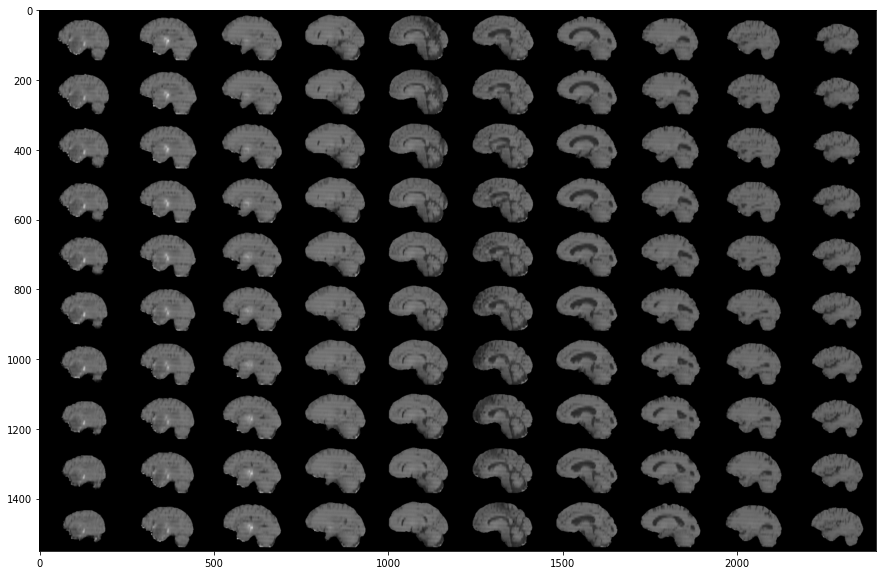

In [10]:
fig, ax1 = plt.subplots(1, 1, figsize = (15,15))
ax1.imshow(rotate(montage(test_image_t1[70:-70,:,:]), 90, resize=True), cmap ='gray')

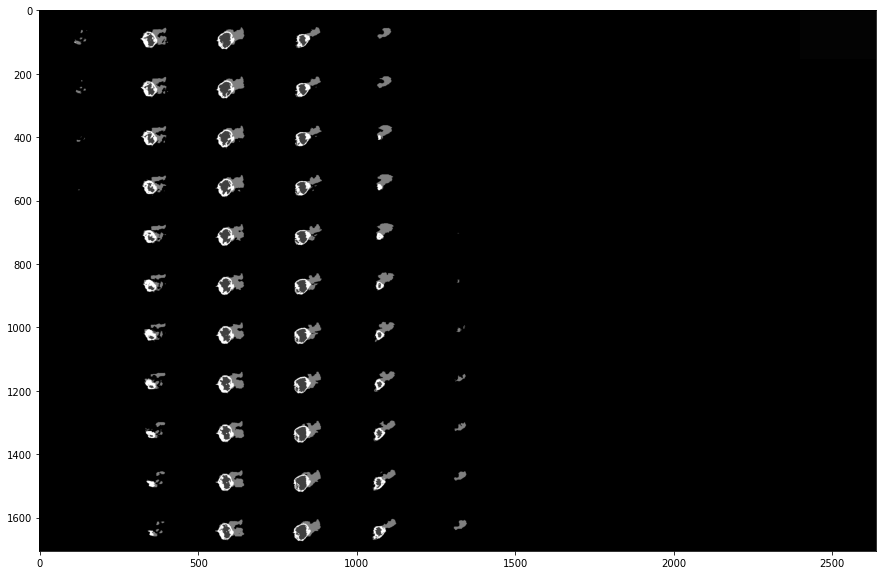

In [11]:
fig, ax1 = plt.subplots(1, 1, figsize = (15,15))
ax1.imshow(rotate(montage(test_mask[50:-70,:,:]), 90, resize=True), cmap ='gray')

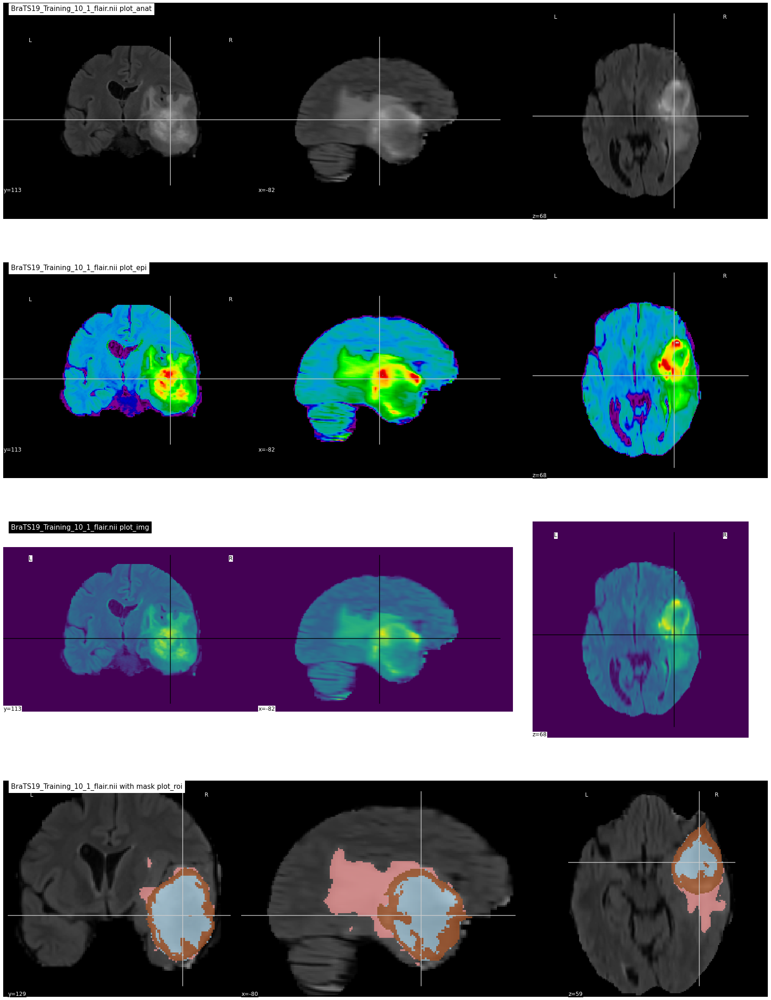

In [12]:
niimg = nl.image.load_img(TRAIN_DATASET_PATH + 'BraTS19_2013_10_1/BraTS19_2013_10_1_flair.nii')
nimask = nl.image.load_img(TRAIN_DATASET_PATH + 'BraTS19_2013_10_1/BraTS19_2013_10_1_seg.nii')

fig, axes = plt.subplots(nrows=4, figsize=(30, 40))


nlplt.plot_anat(niimg,
                title='BraTS19_Training_10_1_flair.nii plot_anat',
                axes=axes[0])

nlplt.plot_epi(niimg,
               title='BraTS19_Training_10_1_flair.nii plot_epi',
               axes=axes[1])

nlplt.plot_img(niimg,
               title='BraTS19_Training_10_1_flair.nii plot_img',
               axes=axes[2])

nlplt.plot_roi(nimask, 
               title='BraTS19_Training_10_1_flair.nii with mask plot_roi',
               bg_img=niimg, 
               axes=axes[3], cmap='Paired')

plt.show()

In [13]:
# dice loss as defined above for 4 classes
def dice_coef(y_true, y_pred, smooth=1.0):
    class_num = 4
    for i in range(class_num):
        y_true_f = K.flatten(y_true[:,:,:,i])
        y_pred_f = K.flatten(y_pred[:,:,:,i])
        intersection = K.sum(y_true_f * y_pred_f)
        loss = ((2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth))
   #     K.print_tensor(loss, message='loss value for class {} : '.format(SEGMENT_CLASSES[i]))
        if i == 0:
            total_loss = loss
        else:
            total_loss = total_loss + loss
            
    total_loss = total_loss / class_num
#    K.print_tensor(total_loss, message=' total dice coef: ')
    return total_loss


 
# define per class evaluation of dice coef
# inspired by https://github.com/keras-team/keras/issues/9395
def dice_coef_necrotic(y_true, y_pred, epsilon=1e-6):
    intersection = K.sum(K.abs(y_true[:,:,:,1] * y_pred[:,:,:,1]))
    return (2. * intersection) / (K.sum(K.square(y_true[:,:,:,1])) + K.sum(K.square(y_pred[:,:,:,1])) + epsilon)

def dice_coef_edema(y_true, y_pred, epsilon=1e-6):
    intersection = K.sum(K.abs(y_true[:,:,:,2] * y_pred[:,:,:,2]))
    return (2. * intersection) / (K.sum(K.square(y_true[:,:,:,2])) + K.sum(K.square(y_pred[:,:,:,2])) + epsilon)

def dice_coef_enhancing(y_true, y_pred, epsilon=1e-6):
    intersection = K.sum(K.abs(y_true[:,:,:,3] * y_pred[:,:,:,3]))
    return (2. * intersection) / (K.sum(K.square(y_true[:,:,:,3])) + K.sum(K.square(y_pred[:,:,:,3])) + epsilon)



# Computing Precision 
def precision(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = true_positives / (predicted_positives + K.epsilon())
        return precision

    
# Computing Sensitivity      
def sensitivity(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    return true_positives / (possible_positives + K.epsilon())


# Computing Specificity
def specificity(y_true, y_pred):
    true_negatives = K.sum(K.round(K.clip((1-y_true) * (1-y_pred), 0, 1)))
    possible_negatives = K.sum(K.round(K.clip(1-y_true, 0, 1)))
    return true_negatives / (possible_negatives + K.epsilon())

In [14]:
def build_unet(inputs, ker_init, dropout):
    conv1 = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(inputs)
    conv1 = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv1)
    
    pool = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool)
    conv = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv)
    
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool1)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv2)
    
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool2)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv3)
    
    
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool4)
    conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv5)
    drop5 = Dropout(dropout)(conv5)

    up7 = Conv2D(256, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(drop5))
    merge7 = concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge7)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv7)

    up8 = Conv2D(128, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv7))
    merge8 = concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge8)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv8)

    up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv8))
    merge9 = concatenate([conv,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge9)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv9)
    
    up = Conv2D(32, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv9))
    merge = concatenate([conv1,up], axis = 3)
    conv = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge)
    conv = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv)
    
    conv10 = Conv2D(4, (1,1), activation = 'softmax')(conv)
    
    return Model(inputs = inputs, outputs = conv10)

input_layer = Input((IMG_SIZE, IMG_SIZE, 2))

model = build_unet(input_layer, 'he_normal', 0.2)
model.compile(loss="categorical_crossentropy", optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), metrics = ['accuracy',tf.keras.metrics.MeanIoU(num_classes=4), dice_coef, precision, sensitivity, specificity, dice_coef_necrotic, dice_coef_edema ,dice_coef_enhancing] )

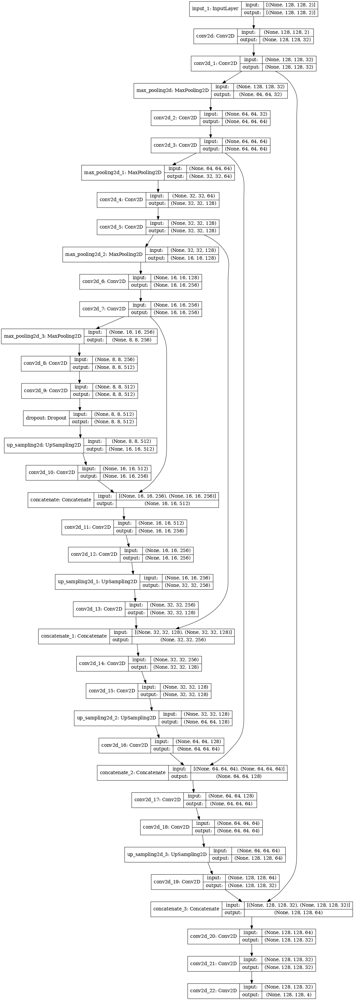

In [15]:
plot_model(model, 
           show_shapes = True,
           show_dtype=False,
           show_layer_names = True, 
           rankdir = 'TB', 
           expand_nested = False, 
           dpi = 70)

In [16]:
# lists of directories with studies
train_and_val_directories = [f.path for f in os.scandir(TRAIN_DATASET_PATH) if f.is_dir()]

# file BraTS20_Training_355 has ill formatted name for for seg.nii file
#train_and_val_directories.remove(TRAIN_DATASET_PATH+'BraTS20_Training_355')


def pathListIntoIds(dirList):
    x = []
    for i in range(0,len(dirList)):
        x.append(dirList[i][dirList[i].rfind('/')+1:])
    return x

train_and_test_ids = pathListIntoIds(train_and_val_directories); 

    
train_test_ids, val_ids = train_test_split(train_and_test_ids,test_size=0.2) 
train_ids, test_ids = train_test_split(train_test_ids,test_size=0.15) 

In [17]:
class DataGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, list_IDs, dim=(IMG_SIZE,IMG_SIZE), batch_size = 1, n_channels = 2, shuffle=True):
        'Initialization'
        self.dim = dim
        self.batch_size = batch_size
        self.list_IDs = list_IDs
        self.n_channels = n_channels
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.list_IDs) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs
        Batch_ids = [self.list_IDs[k] for k in indexes]

        # Generate data
        X, y = self.__data_generation(Batch_ids)

        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __data_generation(self, Batch_ids):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization
        X = np.zeros((self.batch_size*VOLUME_SLICES, *self.dim, self.n_channels))
        y = np.zeros((self.batch_size*VOLUME_SLICES, 240, 240))
        Y = np.zeros((self.batch_size*VOLUME_SLICES, *self.dim, 4))

        
        # Generate data
        for c, i in enumerate(Batch_ids):
            case_path = os.path.join(TRAIN_DATASET_PATH, i)

            data_path = os.path.join(case_path, f'{i}_flair.nii');
            flair = nib.load(data_path).get_fdata()    

            data_path = os.path.join(case_path, f'{i}_t1ce.nii');
            ce = nib.load(data_path).get_fdata()
            
            data_path = os.path.join(case_path, f'{i}_seg.nii');
            seg = nib.load(data_path).get_fdata()
        
            for j in range(VOLUME_SLICES):
                 X[j +VOLUME_SLICES*c,:,:,0] = cv2.resize(flair[:,:,j+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE));
                 X[j +VOLUME_SLICES*c,:,:,1] = cv2.resize(ce[:,:,j+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE));

                 y[j +VOLUME_SLICES*c] = seg[:,:,j+VOLUME_START_AT];
                    
        # Generate masks
        y[y==4] = 3;
        mask = tf.one_hot(y, 4);
        Y = tf.image.resize(mask, (IMG_SIZE, IMG_SIZE));
        return X/np.max(X), Y
        
training_generator = DataGenerator(train_ids)
valid_generator = DataGenerator(val_ids)
test_generator = DataGenerator(test_ids)

In [18]:
print(len(train_ids))
print(len(val_ids))
print(len(test_ids))

175
52
32


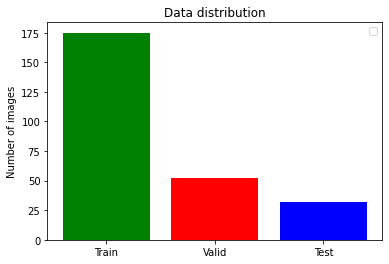

In [19]:
# show number of data for each dir 
def showDataLayout():
    plt.bar(["Train","Valid","Test"],
    [len(train_ids), len(val_ids), len(test_ids)], align='center',color=[ 'green','red', 'blue'])
    plt.legend()

    plt.ylabel('Number of images')
    plt.title('Data distribution')
    plt.savefig('data2019.png')
    plt.show()
    
showDataLayout()

In [21]:
csv_logger = CSVLogger('training_2019_50.log')


history =  model.fit(training_generator,
                    epochs=50,
                    steps_per_epoch=len(train_ids),
                    callbacks= [csv_logger],
                    validation_data = valid_generator
                    )  
model.save("model_2019_50.h5")

Epoch 1/50
175/175 [==============================] - 120s 686ms/step - loss: 0.0762 - accuracy: 0.9837 - mean_io_u: 0.5824 - dice_coef: 0.2808 - precision: 0.9853 - sensitivity: 0.9802 - specificity: 0.9951 - dice_coef_necrotic: 0.0558 - dice_coef_edema: 0.1864 - dice_coef_enhancing: 0.0713 - val_loss: 0.0596 - val_accuracy: 0.9856 - val_mean_io_u: 0.7456 - val_dice_coef: 0.2727 - val_precision: 0.9855 - val_sensitivity: 0.9855 - val_specificity: 0.9952 - val_dice_coef_necrotic: 0.0294 - val_dice_coef_edema: 0.1350 - val_dice_coef_enhancing: 0.0323
Epoch 2/50
175/175 [==============================] - 112s 638ms/step - loss: 0.0720 - accuracy: 0.9835 - mean_io_u: 0.5646 - dice_coef: 0.2886 - precision: 0.9849 - sensitivity: 0.9802 - specificity: 0.9950 - dice_coef_necrotic: 0.0667 - dice_coef_edema: 0.2088 - dice_coef_enhancing: 0.0866 - val_loss: 0.0564 - val_accuracy: 0.9856 - val_mean_io_u: 0.6722 - val_dice_coef: 0.2835 - val_precision: 0.9854 - val_sensitivity: 0.9855 - val_speci

In [23]:
############ load trained model ################
model = tf.keras.models.load_model('../input/model-file/model_2019_50.h5', 
                                   custom_objects={ 'accuracy' : tf.keras.metrics.MeanIoU(num_classes=4),
                                                   "dice_coef": dice_coef,
                                                   "precision": precision,
                                                   "sensitivity":sensitivity,
                                                   "specificity":specificity,
                                                   "dice_coef_necrotic": dice_coef_necrotic,
                                                   "dice_coef_edema": dice_coef_edema,
                                                   "dice_coef_enhancing": dice_coef_enhancing
                                                  }, compile=False)

history = pd.read_csv('../input/model-file/training_2019_50.log', sep=',', engine='python')

hist=history

############### ########## ####### #######

# hist=history.history

acc=hist['accuracy']
val_acc=hist['val_accuracy']

epoch=range(len(acc))

loss=hist['loss']
val_loss=hist['val_loss']

train_dice=hist['dice_coef']
val_dice=hist['val_dice_coef']

f,ax=plt.subplots(1,4,figsize=(16,8))

ax[0].plot(epoch,acc,'b',label='Training Accuracy')
ax[0].plot(epoch,val_acc,'r',label='Validation Accuracy')
ax[0].legend()

ax[1].plot(epoch,loss,'b',label='Training Loss')
ax[1].plot(epoch,val_loss,'r',label='Validation Loss')
ax[1].legend()

ax[2].plot(epoch,train_dice,'b',label='Training dice coef')
ax[2].plot(epoch,val_dice,'r',label='Validation dice coef')
ax[2].legend()

ax[3].plot(epoch,hist['mean_io_u'],'b',label='Training mean IOU')
ax[3].plot(epoch,hist['val_mean_io_u'],'r',label='Validation mean IOU')
ax[3].legend()
plt.savefig('training_result_2019.png')
plt.show()

OSError: SavedModel file does not exist at: ../input/model-file/model_2019_50.h5/{saved_model.pbtxt|saved_model.pb}

In [24]:
# mri type must one of 1) flair 2) t1 3) t1ce 4) t2 ------- or even 5) seg
# returns volume of specified study at `path`
def imageLoader(path):
    image = nib.load(path).get_fdata()
    X = np.zeros((self.batch_size*VOLUME_SLICES, *self.dim, self.n_channels))
    for j in range(VOLUME_SLICES):
        X[j +VOLUME_SLICES*c,:,:,0] = cv2.resize(image[:,:,j+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE));
        X[j +VOLUME_SLICES*c,:,:,1] = cv2.resize(ce[:,:,j+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE));

        y[j +VOLUME_SLICES*c] = seg[:,:,j+VOLUME_START_AT];
    return np.array(image)


# load nifti file at `path`
# and load each slice with mask from volume
# choose the mri type & resize to `IMG_SIZE`
def loadDataFromDir(path, list_of_files, mriType, n_images):
    scans = []
    masks = []
    for i in list_of_files[:n_images]:
        fullPath = glob.glob( i + '/*'+ mriType +'*')[0]
        currentScanVolume = imageLoader(fullPath)
        currentMaskVolume = imageLoader( glob.glob( i + '/*seg*')[0] ) 
        # for each slice in 3D volume, find also it's mask
        for j in range(0, currentScanVolume.shape[2]):
            scan_img = cv2.resize(currentScanVolume[:,:,j], dsize=(IMG_SIZE,IMG_SIZE), interpolation=cv2.INTER_AREA).astype('uint8')
            mask_img = cv2.resize(currentMaskVolume[:,:,j], dsize=(IMG_SIZE,IMG_SIZE), interpolation=cv2.INTER_AREA).astype('uint8')
            scans.append(scan_img[..., np.newaxis])
            masks.append(mask_img[..., np.newaxis])
    return np.array(scans, dtype='float32'), np.array(masks, dtype='float32')
        
#brains_list_test, masks_list_test = loadDataFromDir(VALIDATION_DATASET_PATH, test_directories, "flair", 5)

In [26]:
def predictByPath(case_path,case):
    files = next(os.walk(case_path))[2]
    X = np.empty((VOLUME_SLICES, IMG_SIZE, IMG_SIZE, 2))
  #  y = np.empty((VOLUME_SLICES, IMG_SIZE, IMG_SIZE))
    
    vol_path = os.path.join(case_path, f'BraTS19_{case}_flair.nii');
    flair=nib.load(vol_path).get_fdata()
    
    vol_path = os.path.join(case_path, f'BraTS19_{case}_t1ce.nii');
    ce=nib.load(vol_path).get_fdata() 
    
 #   vol_path = os.path.join(case_path, f'BraTS20_Training_{case}_seg.nii');
 #   seg=nib.load(vol_path).get_fdata()  

    
    for j in range(VOLUME_SLICES):
        X[j,:,:,0] = cv2.resize(flair[:,:,j+VOLUME_START_AT], (IMG_SIZE,IMG_SIZE))
        X[j,:,:,1] = cv2.resize(ce[:,:,j+VOLUME_START_AT], (IMG_SIZE,IMG_SIZE))
 #       y[j,:,:] = cv2.resize(seg[:,:,j+VOLUME_START_AT], (IMG_SIZE,IMG_SIZE))
        
  #  model.evaluate(x=X,y=y[:,:,:,0], callbacks= callbacks)
    return model.predict(X/np.max(X), verbose=1)


def showPredictsById(case, start_slice = 60):
    path = f"../input/brain-tumor-segmentation-brats-2019/MICCAI_BraTS_2019_Data_Training/HGG/BraTS19_2013_{case}"
    gt = nib.load(os.path.join(path, f'BraTS19_{case}_seg.nii')).get_fdata()
    origImage = nib.load(os.path.join(path, f'BraTS19_{case}_flair.nii')).get_fdata()
    p = predictByPath(path,case)

    core = p[:,:,:,1]
    edema= p[:,:,:,2]
    enhancing = p[:,:,:,3]

    plt.figure(figsize=(18, 50))
    f, axarr = plt.subplots(1,6, figsize = (18, 50)) 

    for i in range(6): # for each image, add brain background
        axarr[i].imshow(cv2.resize(origImage[:,:,start_slice+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE)), cmap="gray", interpolation='none')
    
    axarr[0].imshow(cv2.resize(origImage[:,:,start_slice+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE)), cmap="gray")
    axarr[0].title.set_text('Original image flair')
    curr_gt=cv2.resize(gt[:,:,start_slice+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE), interpolation = cv2.INTER_NEAREST)
    axarr[1].imshow(curr_gt, cmap="Reds", interpolation='none', alpha=0.3) # ,alpha=0.3,cmap='Reds'
    axarr[1].title.set_text('Ground truth')
    axarr[2].imshow(p[start_slice,:,:,1:4], cmap="Reds", interpolation='none', alpha=0.3)
    axarr[2].title.set_text('all classes')
    axarr[3].imshow(edema[start_slice,:,:], cmap="OrRd", interpolation='none', alpha=0.3)
    axarr[3].title.set_text(f'{SEGMENT_CLASSES[1]} predicted')
    axarr[4].imshow(core[start_slice,:,], cmap="OrRd", interpolation='none', alpha=0.3)
    axarr[4].title.set_text(f'{SEGMENT_CLASSES[2]} predicted')
    axarr[5].imshow(enhancing[start_slice,:,], cmap="OrRd", interpolation='none', alpha=0.3)
    axarr[5].title.set_text(f'{SEGMENT_CLASSES[3]} predicted')
    plt.savefig('Test_01.png')
    plt.show()
    
    
showPredictsById(case=test_ids[0][-3:])
#showPredictsById(case=test_ids[1][-3:])
#showPredictsById(case=test_ids[2][-3:])
#showPredictsById(case=test_ids[3][-3:])
#showPredictsById(case=test_ids[4][-3:])
#showPredictsById(case=test_ids[5][-3:])
#showPredictsById(case=test_ids[6][-3:])

FileNotFoundError: No such file or no access: '../input/brain-tumor-segmentation-brats-2019/MICCAI_BraTS_2019_Data_Training/HGG/BraTS19_2013_N_1/BraTS19_N_1_seg.nii'

In [ ]:
case = case=test_ids[3][-3:]
path = f"../input/brain-tumor-segmentation-brats-2019/MICCAI_BraTS_2019_Data_Training/HGG/BraTS19_2013_{case}"
gt = nib.load(os.path.join(path, f'BraTS19_{case}_seg.nii')).get_fdata()
p = predictByPath(path,case)


core = p[:,:,:,1]
edema= p[:,:,:,2]
enhancing = p[:,:,:,3]


i=40 # slice at
eval_class =3 #     0 : 'NOT tumor',  1 : 'ENHANCING',    2 : 'CORE',    3 : 'WHOLE'



gt[gt != eval_class] = 1 # use only one class for per class evaluation 

resized_gt = cv2.resize(gt[:,:,i+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE))

plt.figure()
f, axarr = plt.subplots(1,2) 
axarr[0].imshow(resized_gt, cmap="gray")
axarr[0].title.set_text('ground truth')
axarr[1].imshow(p[i,:,:,eval_class], cmap="gray")
axarr[1].title.set_text(f'predicted class: {SEGMENT_CLASSES[eval_class]}')
plt.show()

In [ ]:
csv_logger = CSVLogger('./evaluation_50.log')
model.compile(loss="categorical_crossentropy", optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), metrics = ['accuracy',tf.keras.metrics.MeanIoU(num_classes=4), dice_coef, precision, sensitivity, specificity, dice_coef_necrotic, dice_coef_edema, dice_coef_enhancing] )
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
results = model.evaluate(test_generator, batch_size=100, callbacks= [csv_logger])
print("test loss, test acc:", results)

In [31]:
import numpy as np
import pydicom
from pydicom.pixel_data_handlers.util import apply_modality_lut 
import os
import matplotlib.pyplot as plt
from glob import glob
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import scipy.ndimage
from scipy.spatial import ConvexHull
from skimage import morphology
from skimage import measure
from skimage.transform import resize
from sklearn.cluster import KMeans
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.graph_objs import *
init_notebook_mode(connected=True) 

import h5py

import nibabel as nib
import SimpleITK as sitk
import sys
import time
import os
import numpy as np
import cv2

import tensorflow as tf
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping

In [29]:
!pip install SimpleITK
!pip install pydicom

In [32]:
new_img = sitk.ReadImage('/kaggle/input/brain-tumor-segmentation-brats-2019/MICCAI_BraTS_2019_Data_Training/HGG/BraTS19_2013_12_1/BraTS19_2013_12_1_flair.nii')
print(new_img.GetDepth())

155


In [35]:
import SimpleITK as sitk

import sys
import time
import os
import numpy as np

pixel_dtypes = {"int16": np.int16,
                "float64": np.float64}


def writeSlices(series_tag_values, new_img, out_dir, i):
    image_slice = new_img[:, :, i]

    list(map(lambda tag_value: image_slice.SetMetaData(tag_value[0],
                                                       tag_value[1]),
             series_tag_values))

    image_slice.SetMetaData("0008|0012", time.strftime("%Y%m%d"))
    image_slice.SetMetaData("0008|0013", time.strftime("%H%M%S"))

    # Setting the type to CT so that the slice location is preserved and
    # the thickness is carried over.
    image_slice.SetMetaData("0008|0060", "CT")

    # (0020, 0032) image position patient determines the 3D spacing between
    # slices.
    #   Image Position (Patient)
    image_slice.SetMetaData("0020|0032", '\\'.join(
        map(str, new_img.TransformIndexToPhysicalPoint((0, 0, i)))))
    #   Instance Number
    image_slice.SetMetaData("0020,0013", str(i))

    # Write to the output directory and add the extension dcm, to force
    # writing in DICOM format.
    writer.SetFileName(os.path.join(out_dir, str(i) + '.dcm'))
    writer.Execute(image_slice)

# Create a new series from a numpy array
try:
    pixel_dtype = pixel_dtypes["float64"]
except KeyError:
    pixel_dtype = pixel_dtypes["int16"]


writer = sitk.ImageFileWriter()
# Use the study/series/frame of reference information given in the meta-data
# dictionary and not the automatically generated information from the file IO
writer.KeepOriginalImageUIDOn()




if pixel_dtype == np.float64:
    def tag_func(i):
        rescale_slope = 0.01  # keep three digits after the decimal point
        modification_time = time.strftime("%H%M%S")
        modification_date = time.strftime("%Y%m%d")

        direction = new_img.GetDirection()
        series_tag_values = [
        ("0008|0031", modification_time),  # Series Time
        ("0008|0021", modification_date),  # Series Date
        ("0008|0008", "DERIVED\\SECONDARY"),  # Image Type
        ("0020|000e", "1.2.826.0.1.3680043.2.1125."
         + modification_date + ".1" + modification_time),  # Series Instance UID
        ("0020|0037", '\\'.join(map(str, (direction[0], direction[3], direction[6],
                                          direction[1], direction[4],
                                          direction[7])))),  # Image Orientation
        # (Patient)
        ("0008|103e", "Created-SimpleITK")  # Series Description
    ]
        series_tag_values = series_tag_values + [
            ('0028|1053', str(rescale_slope)),  # rescale slope
            ('0028|1052', '0'),  # rescale intercept
            ('0028|0100', '16'),  # bits allocated
            ('0028|0101', '16'),  # bits stored
            ('0028|0102', '15'),  # high bit
            ('0028|0103', '1'), # pixel representation
            ('0020|0013', str(i))] #Instance Number
        return series_tag_values

# Write slices to output directory
list(map(lambda i: writeSlices(tag_func(i), new_img, './brain_dicom', i),
         range(new_img.GetDepth())))
print('Done')


Done


In [34]:
!mkdir /kaggle/working/brain_dicom

In [36]:
#Checking our first dicom file
a = pydicom.read_file('./brain_dicom/0.dcm')
a

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 258
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: CT Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.826.0.1.3680043.2.1125.1.71626444412716426405134727848319607
(0002, 0010) Transfer Syntax UID                 UI: Implicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.2.826.0.1.3680043.2.1143.107.104.103.115.3.0.10.111.124.113
(0002, 0013) Implementation Version Name         SH: 'GDCM 3.0.10'
(0002, 0016) Source Application Entity Title     AE: 'GDCM/ITK 5.3.0'
-------------------------------------------------
(0008, 0008) Image Type                          CS: ['DERIVED', 'SECONDARY']
(0008, 0012) Instance Creation Date              DA: '20230902'
(0008, 0013) Instance Creation Time              TM: '163409'
(0008, 0016) SOP Class UID                       UI: CT

In [37]:
def resample(image, new_spacing=[1,1,1]):
    spacing = np.array([1,1,1])


    resize_factor = spacing / new_spacing
    new_real_shape = image.shape * resize_factor
    new_shape = np.round(new_real_shape)
    real_resize_factor = new_shape / image.shape
    new_spacing = spacing / real_resize_factor
    
    image = scipy.ndimage.interpolation.zoom(image, real_resize_factor)
    
    return image


In [40]:
flair=nib.load('/kaggle/input/brain-tumor-segmentation-brats-2019/MICCAI_BraTS_2019_Data_Training/HGG/BraTS19_2013_12_1/BraTS19_2013_12_1_flair.nii').get_fdata()
flair.shape

(240, 240, 155)

In [41]:
h = flair.shape[0]/128
c = flair.shape[2]/100
flair = resample(flair,[h,h,c])
flair.shape

(128, 128, 100)

In [44]:
t1ce = nib.load('/kaggle/input/brain-tumor-segmentation-brats-2019/MICCAI_BraTS_2019_Data_Training/HGG/BraTS19_2013_12_1/BraTS19_2013_12_1_flair.nii').get_fdata()
t1ce.shape

(240, 240, 155)

In [45]:
t1ce = resample(t1ce,[h,h,c])
t1ce.shape

(128, 128, 100)

In [48]:
X = np.zeros((100, 128,128, 2))
IMG_SIZE=128

for j in range(100):
     X[j ,:,:,0] = cv2.resize(flair[:,:,j], (IMG_SIZE, IMG_SIZE));
     X[j ,:,:,1] = cv2.resize(t1ce[:,:,j], (IMG_SIZE, IMG_SIZE));

X = X/np.max(X)
print(X.shape)

(100, 128, 128, 2)


In [49]:
IMG_SIZE=128
def build_unet(inputs, ker_init, dropout):
    conv1 = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(inputs)
    conv1 = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv1)
    
    pool = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool)
    conv = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv)
    
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool1)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv2)
    
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool2)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv3)
    
    
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool4)
    conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv5)
    drop5 = Dropout(dropout)(conv5)

    up7 = Conv2D(256, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(drop5))
    merge7 = concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge7)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv7)
    
    up8 = Conv2D(128, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv7))
    merge8 = concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge8)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv8)

    up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv8))
    merge9 = concatenate([conv,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge9)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv9)
    
    up = Conv2D(32, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv9))
    merge = concatenate([conv1,up], axis = 3)
    conv = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge)
    conv = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv)
    
    conv10 = Conv2D(4, (1,1), activation = 'softmax')(conv)
    
    return Model(inputs = inputs, outputs = conv10)

input_layer = Input((IMG_SIZE, IMG_SIZE, 2))

model = build_unet(input_layer, 'he_normal', 0.2)

In [51]:
#Loading the model we have trained
model = tf.keras.models.load_model('/kaggle/working/model_2019_50.h5',compile=False)

In [52]:
#getting the segmentation masks
y_pred = model.predict(X)

In [53]:
#rounding off the label predictions
tumor = y_pred[:,:,:,3]
# tumor = np.round(tumor)
tumor[tumor>0.5]=1
tumor[tumor<=0.5]=0

In [54]:
tumor.shape

(100, 128, 128)

In [55]:
brain_paths=glob('brain_dicom/*.dcm')

In [56]:
def load_scan(paths):
    slices = [pydicom.read_file(path ) for path in paths]
    slices.sort(key = lambda x: int(x.InstanceNumber), reverse = False)
    try:
        slice_thickness = np.abs(slices[0].ImagePositionPatient[2] - slices[1].ImagePositionPatient[2])
    except:
        slice_thickness = np.abs(slices[0].SliceLocation - slices[1].SliceLocation)
        
    for s in slices:
        s.SliceThickness = slice_thickness
        
    return slices

In [57]:
def get_pixels_hu(scans):
    image = np.stack([s.pixel_array for s in scans])
    # Convert to int16 (from sometimes int16), 
    # should be possible as values should always be low enough (<32k)
    image = image.astype(np.int16)

    # Set outside-of-scan pixels to 1
    # The intercept is usually -1024, so air is approximately 0
    image[image == -2000] = 0
    
    # Convert to Hounsfield units (HU)
    intercept = scans[0].RescaleIntercept
    slope = scans[0].RescaleSlope
    
    if slope != 1:
        image = slope * image.astype(np.float64)
        image = image.astype(np.int16)
        
    image += np.int16(intercept)
    
    return np.array(image, dtype=np.int16)

In [58]:
brains = load_scan(brain_paths)
imgs1 = get_pixels_hu(brains)
np.save(f'fullimages_brain.npy', imgs1)

In [60]:
def find_volume(Data,):
    Volume=0;
    for i in range(Data.shape[0]):
        for j in range (Data.shape[1]):
            Area = 0.1 * brains[i].PixelSpacing[0] * 0.1 * brains[i].PixelSpacing[1] * np.count_nonzero(Data[i,j])
            Volume += 0.1 * brains[i].SliceThickness * Area
    return Volume


In [61]:
brain_volume = find_volume(imgs1)
tumor_volume = find_volume(tumor)
print('Brain volume:',brain_volume,'Tumor volume:',tumor_volume)

Brain volume: 1256.286000000015 Tumor volume: 12.878999999999966


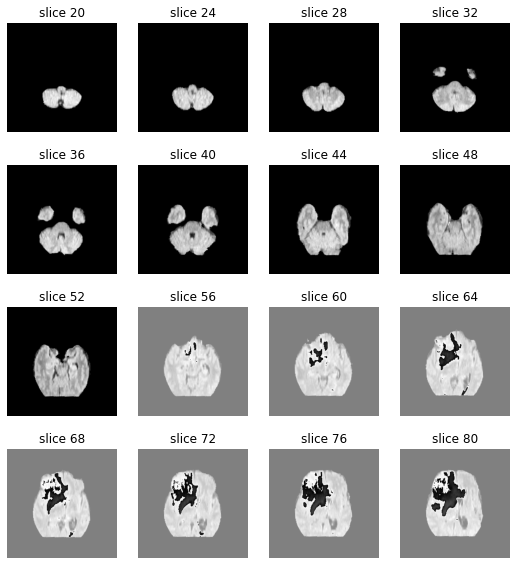

In [62]:
file_used= f'./fullimages_brain.npy'
imgs_to_process = np.load(file_used).astype(np.float64) 

def sample_stack(stack, rows=4, cols=4, start_with=20, show_every=4):
    fig,ax = plt.subplots(rows,cols,figsize=[9,10])
    for i in range(rows*cols):
        ind = start_with + i*show_every
        ax[int(i/rows),int(i % rows)].set_title(f'slice {ind}')
        ax[int(i/rows),int(i % rows)].imshow(stack[ind],cmap='gray')
        ax[int(i/rows),int(i % rows)].axis('off')
    plt.show()

sample_stack(imgs_to_process)

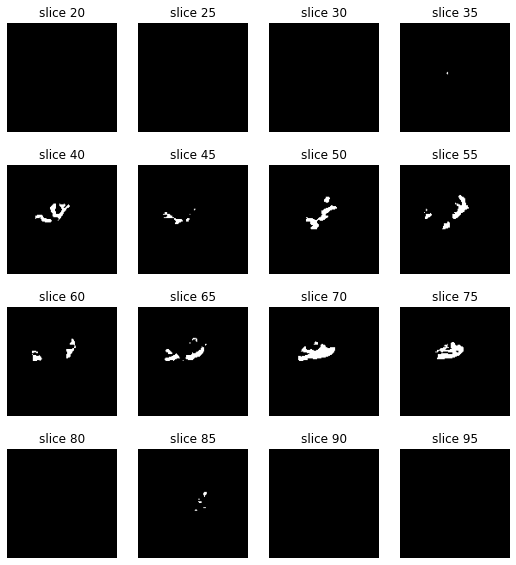

In [63]:
def sample_stack(stack, rows=4, cols=4, start_with=20, show_every=5):
    fig,ax = plt.subplots(rows,cols,figsize=[9,10])
    for i in range(rows*cols):
        ind = start_with + i*show_every
        ax[int(i/rows),int(i % rows)].set_title(f'slice {ind}')
        ax[int(i/rows),int(i % rows)].imshow(stack[ind],cmap='gray')
        ax[int(i/rows),int(i % rows)].axis('off')
    plt.show()

sample_stack(tumor)

In [64]:
file_used= f'./fullimages_brain.npy'
imgs_to_process = np.load(file_used).astype(np.float64)
print(f'Shape before resampling: {imgs_to_process.shape}')
imgs_after_resamp = resample(imgs_to_process, [1,1,1])
print(f'Shape after resampling: {imgs_after_resamp.shape}')
spac = 100/len(imgs_to_process)
spac2 = 128/imgs_to_process.shape[1]
tumor= resample(tumor,[spac,spac2,spac2])
print('Tumor after reshape:',tumor.shape)

Shape before resampling: (155, 240, 240)
Shape after resampling: (155, 240, 240)
Tumor after reshape: (155, 240, 240)


In [65]:
def make_mesh(image,istransp='true', threshold=-300, step_size=1):

    print("Transposing surface")
    p = image.transpose(2,1,0)
    
    print("Calculating surface")
    verts, faces, norm, val = measure.marching_cubes(p, threshold, step_size=step_size, allow_degenerate=True)
    
    return verts, faces

In [66]:
def plotly_3d(verts, faces, verts2, faces2):
    x,y,z = zip(*verts) 
    x2,y2,z2 = zip(*verts2)
       
    
#     Make the colormap single color since the axes are positional not intensity. 
    colormap=['rgba(255, 0, 0,0.5)','rgba(255, 0, 0,0.5)']
    
    fig = ff.create_trisurf(x=x, y=y, z=z, plot_edges=False,
                        colormap=colormap,
                        show_colorbar=False,
                        simplices=faces,
                        backgroundcolor='rgb(64, 64, 64)',
                        title="Interactive Visualization")
    
    
    colormap2=['rgba(0, 255, 0,0.8)','rgba(0, 255, 0,0.8)']
    
    fig2 = ff.create_trisurf(x=x2, y=y2, z=z2, plot_edges=False,
                        colormap=colormap2,
                        show_colorbar=False,
                        simplices=faces2,
                        backgroundcolor='rgb(64, 64, 64)',
                        title="Interactive Visualization")
    fig['data'][0].update(opacity=0.2)
    
    



    
    data = [fig.data[0],fig2.data[0]]
    


    fig3 = dict(data=data)
    
    iplot(fig3)

In [67]:
imgs_after_resamp.shape

(155, 240, 240)

In [68]:
tumor = tumor*255.0

In [69]:
tumor.shape

(155, 240, 240)

In [70]:
np.max(imgs_after_resamp)

327.00000000000057

In [71]:
v, f = make_mesh(imgs_after_resamp,istransp=True, threshold = 20) #350 previously default value
v2, f2 = make_mesh(tumor,istransp=False, threshold = 50) #350 previously default value

Transposing surface
Calculating surface
Transposing surface
Calculating surface


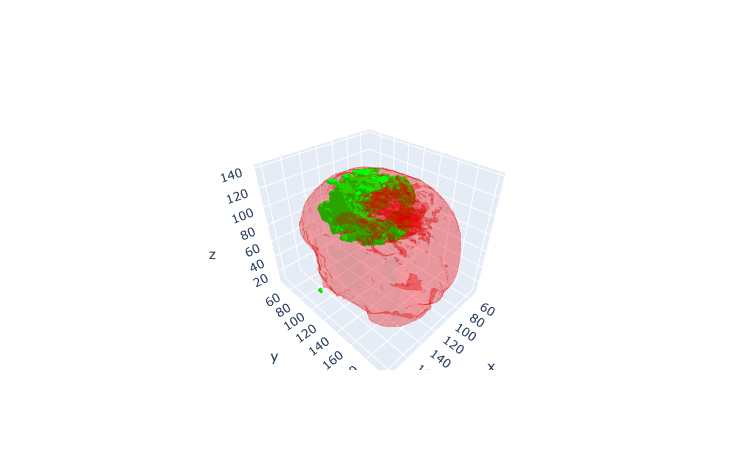

In [72]:
plotly_3d(v, f,v2,f2)